In [29]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt

# Load data

In [30]:
# Load data 
filename = 'soc-sign-bitcoinotc.csv'
df = pd.read_csv('./data/{}'.format(filename), header = None, names = ['SOURCE', 'TARGET', 'RATING', 'TIME'])

In [31]:
df.shape

(35592, 4)

In [32]:
df.head()

,SOURCE,TARGET,RATING,TIME
0,6,2,4,1.289242e+09
1,6,5,2,1.289242e+09
2,1,15,1,1.289243e+09
3,4,3,7,1.289245e+09
4,13,16,8,1.289254e+09


In [33]:
# delete 'TIME' column
df.drop(labels = 'TIME', axis = 1, inplace = True)

In [34]:
df.head()

,SOURCE,TARGET,RATING
0,6,2,4
1,6,5,2
2,1,15,1
3,4,3,7
4,13,16,8


In [38]:
df.tail()

,SOURCE,TARGET,RATING
35587,4499,1810,1
35588,2731,3901,1
35589,2731,4897,1
35590,13,1128,1
35591,1128,13,1


# Data processing

In [36]:
# Delete edges with 0 weight
df.drop(df[df['RATING'] == 0].index)

,SOURCE,TARGET,RATING
0,6,2,4
1,6,5,2
2,1,15,1
3,4,3,7
4,13,16,8
...,...,...,...
35587,4499,1810,1
35588,2731,3901,5
35589,2731,4897,5
35590,13,1128,1


In [43]:
# Divide edge signs into positive and negative categories
df['RATING'][df.RATING < 0] = -1
df['RATING'][df.RATING > 0] = 1
df.describe()

,SOURCE,TARGET,RATING
count,35592.000000,35592.000000,35592.000000
mean,2353.847269,2417.478254,0.799786
std,1605.771178,1658.232170,0.600293
min,1.000000,1.000000,-1.000000
25%,988.000000,978.000000,1.000000
50%,2125.000000,2178.000000,1.000000
75%,3722.000000,3804.000000,1.000000
max,6000.000000,6005.000000,1.000000


In [44]:
# Convert directed graph to undirected graph

# We assume that if node A thinks node B is her/his friend, 
# then node B must also think node A is her/his friend.

# If there is an edge from A to B, 
# we delete the edge from B to A (if it exists).
 
df.loc[pd.DataFrame(np.sort(df[['SOURCE','TARGET']], 1),index = df.index).drop_duplicates(keep = 'first').index]
df

,SOURCE,TARGET,RATING
0,6,2,1
1,6,5,1
2,1,15,1
3,4,3,1
4,13,16,1
...,...,...,...
35587,4499,1810,1
35588,2731,3901,1
35589,2731,4897,1
35590,13,1128,1


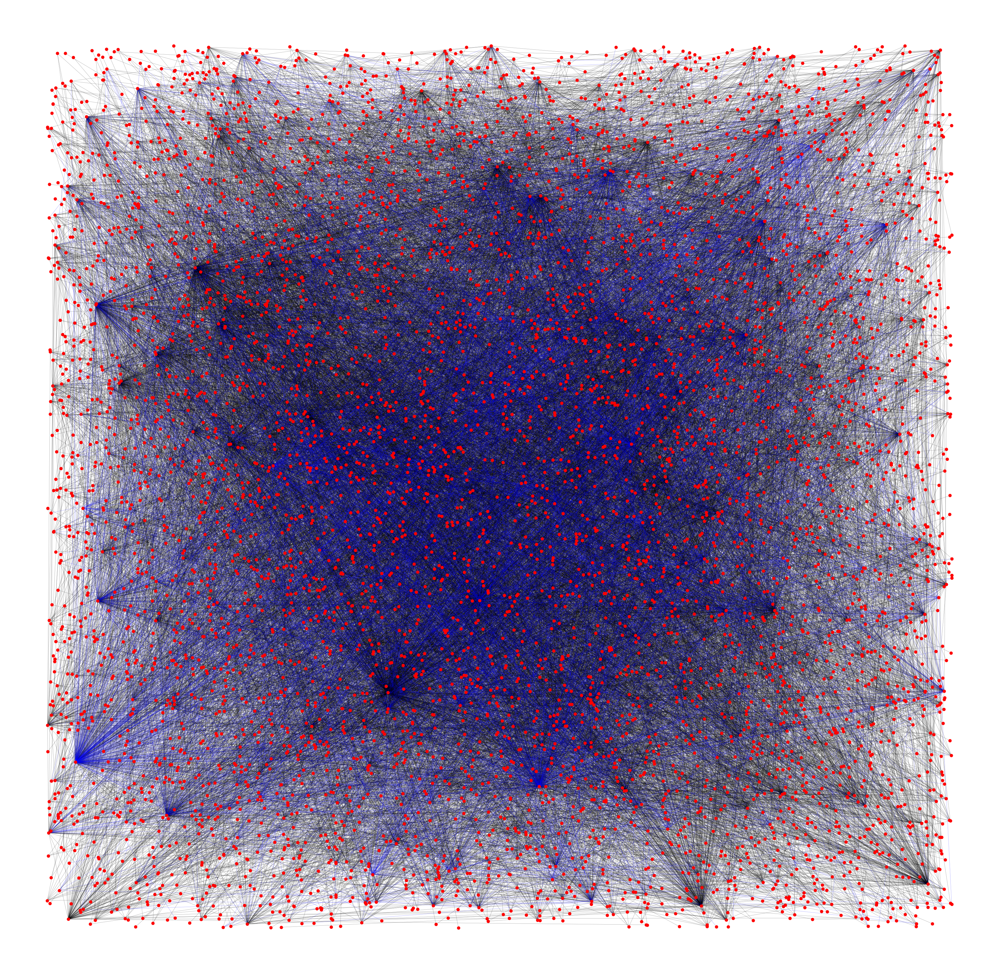

In [48]:
# Generate a new undirected graph
G = nx.Graph()


for index in df.index:
    G.add_edge(df['SOURCE'][index], df['TARGET'][index], weight = df['RATING'][index])


# Graph visualization    
epositive = [(u, v) for (u, v, d) in G.edges(data = True) if d['weight'] > 0] 
enegative = [(u, v) for (u, v, d) in G.edges(data = True) if d['weight'] < 0]    

plt.figure(figsize=(65,65))

pos = nx.random_layout(G)   

# nodes
nx.draw_networkx_nodes(G, pos, node_size=120, node_color='r')

# edges
nx.draw_networkx_edges(G, pos, edgelist = epositive, width=0.6, alpha=0.5)
nx.draw_networkx_edges(G, pos, edgelist = enegative, width=0.6, alpha=0.5, edge_color = 'b')

# labels
nx.draw_networkx_labels(G, pos, font_size=1)

# nx.draw(G, with_labels=True,  pos = pos, node_size = 120, alpha = 0.6, width = 0.6)

plt.axis('off')
plt.show()

In [47]:
nx.info(G)

'Name: \nType: Graph\nNumber of nodes: 5881\nNumber of edges: 21492\nAverage degree:   7.3090'